In [60]:
import shapefile
import re
import pandas as pd
import geopy.distance
from tqdm import tqdm_notebook
from shapely.geometry import Polygon
import geopandas as gpd
import fiona

columns = ["Census Block ID", "Lat", "Lon"]

df = pd.DataFrame(columns=columns)
city_df = pd.read_csv("city-basics_iowa.csv")

shape = shapefile.Reader("gz_2010_19_150_00_500k.shp")
#fiona_collection = fiona.open("gz_2010_19_150_00_500k.shp")
#gdf = gpd.GeoDataFrame.from_features([feature for feature in fiona_collection])

for feature in shape.shapeRecords():
    blockId = re.sub("[\d]+US", "", feature.record[0])
    if (feature.shape.__geo_interface__["type"] is "MultiPolygon"):
        centerX = sum([p[0] for p in feature.shape.__geo_interface__["coordinates"][0][0]])/len(feature.shape.__geo_interface__["coordinates"][0][0])
        centerY = sum([p[1] for p in feature.shape.__geo_interface__["coordinates"][0][0]])/len(feature.shape.__geo_interface__["coordinates"][0][0])
        centroid = (centerX, centerY)
    else:
        centerX = sum([p[0] for p in feature.shape.__geo_interface__["coordinates"][0]])/len(feature.shape.__geo_interface__["coordinates"][0])
        centerY = sum([p[1] for p in feature.shape.__geo_interface__["coordinates"][0]])/len(feature.shape.__geo_interface__["coordinates"][0])
        centroid = (centerX, centerY)

    df.loc[len(df)] = [blockId, centroid[1], centroid[0]]
    
city_df = city_df.drop([city_df.columns[0], "Counties", "WikiURL"], axis=1)

In [69]:
def getLLDist(row, coord1):
    coord2 = (row["Lat"], row["Lon"])
    return (geopy.distance.vincenty(coord1, coord2).km, row["City"])

def getClosestCity(row):
    coord1 = (row["Lat"], row["Lon"])
    return min(city_df.apply(getLLDist, coord1=coord1, axis=1))

df["Distance to City Center"], df["City"] = zip(*df.apply(getClosestCity, axis=1))

In [70]:
censusDict = df[["Census Block ID", "City"]].set_index("Census Block ID").to_dict()["City"]
latDict = df[["City", "Lat"]].set_index("City").to_dict()["Lat"]
lonDict = df[["City", "Lon"]].set_index("City").to_dict()["Lon"]

latDf = pd.DataFrame.from_dict(latDict, orient="index").reset_index()
lonDf = pd.DataFrame.from_dict(lonDict, orient="index").reset_index()
censusDf = pd.DataFrame.from_dict(censusDict, orient="index").reset_index()

latDf.to_csv("city-latitude.csv")
lonDf.to_csv("city-longitude.csv")
censusDf.to_csv("city-block.csv")
df.to_csv("block-city-mapping.csv")

In [71]:
lodes_df = pd.read_csv("ia_od_main_JT00_2010.csv")
lodes_df = lodes_df.drop(['createdate'], axis=1)
lodes_df.columns = ["work block", "home block", "total jobs", "Age [0-29]", "Age [30-54]", "Age [55+]", "Salary, Monthly [0-1250]", "Salary, Monthly [1251-3333]", "Salary, Monthly [3334+]", "Jobs: Goods Producing", "Jobs: Trade, Transport, Utilities", "Jobs: Other"]

lodes_df["wb census"] = lodes_df["work block"].apply(lambda x: str(x)[:12])
lodes_df["hb census"] = lodes_df["home block"].apply(lambda x: str(x)[:12])
lodes_df["year"] = "2010"


In [72]:
def getCity(censusBlock):
    return censusDict[censusBlock]
#     return df[df["Census Block ID"] == censusBlock]["City"]
    
testSet = lodes_df
testSet = testSet.drop(['work block', 'home block'], axis=1)
testSet = testSet.groupby(['wb census', 'hb census']).sum().reset_index()
testSet["home city"] = testSet["hb census"].apply(getCity)
testSet = testSet.drop("hb census", axis=1)
testSet["work city"] = testSet["wb census"].apply(getCity)
testSet = testSet.drop("wb census", axis=1)
testSet.sort_values(["home city", "work city"], inplace=True)
testSet.set_index(["home city", "work city"], inplace=True)

#jobSet = testSet.drop(['wb census', 'hb census'], axis=1)
#jobSet = jobSet.groupby(['city name']).sum().reset_index()
#testSet = jobSet.merge(workSet, on='city name')

#testSet = testSet.merge(pd.DataFrame(testSet.groupby(['city name'])['wb census'].apply(list)).reset_index(), on="city name", how="left")
#testSet = testSet.drop(["wb census_x"], axis=1).reset_index()
#testSet = testSet.drop(['index'], axis=1)
#testSet = testSet.rename(columns = {"wb census_y":"work blocks"})
#workSet = testSet[["work blocks", "city name"]].reset_index().drop(["index"], axis=1)
#jobSet = testSet.drop(['work blocks', 'hb census'], axis=1).groupby(['city name']).sum().reset_index()
#testSet = testSet.rename(columns = {'wb census':'work blocks'})

In [73]:
testSet.to_csv("lodes_data.csv")

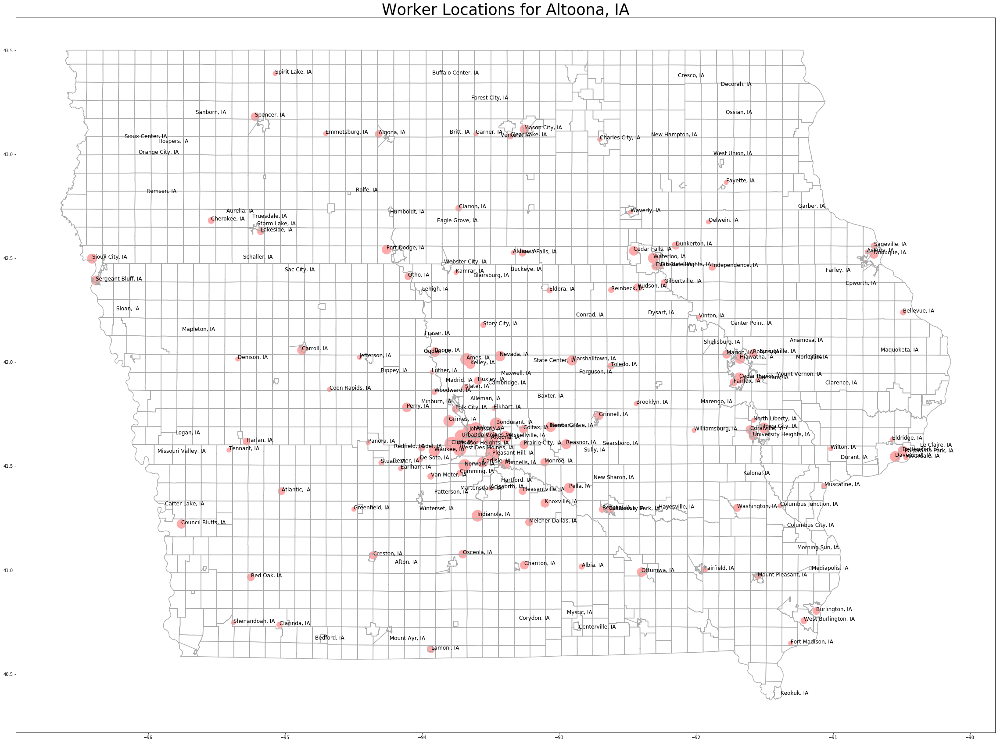

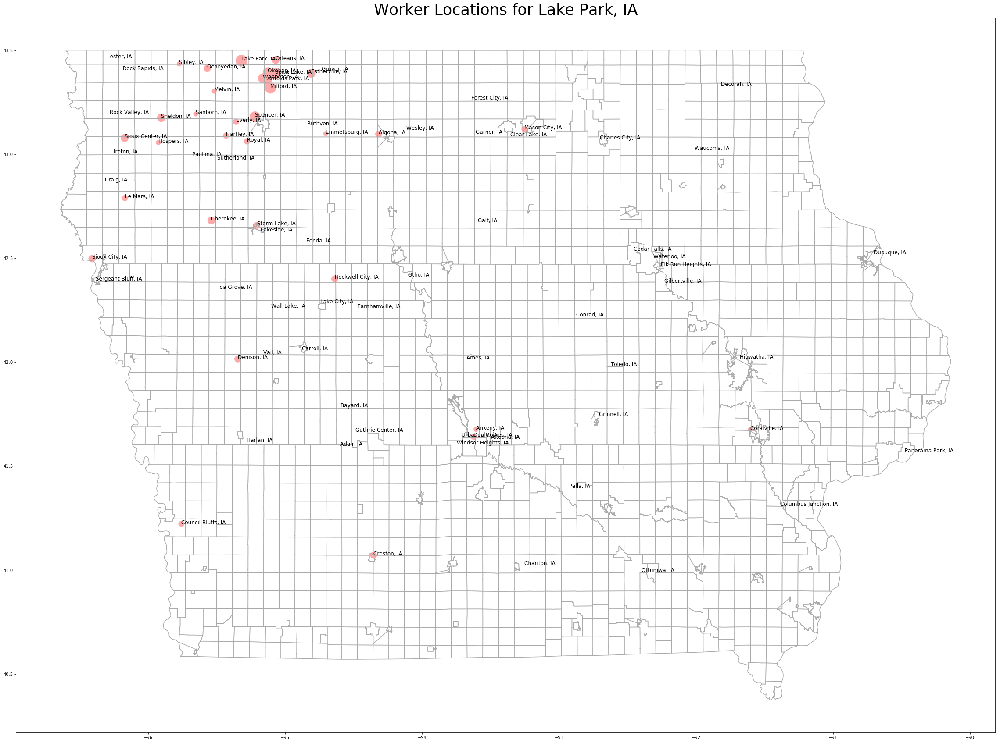

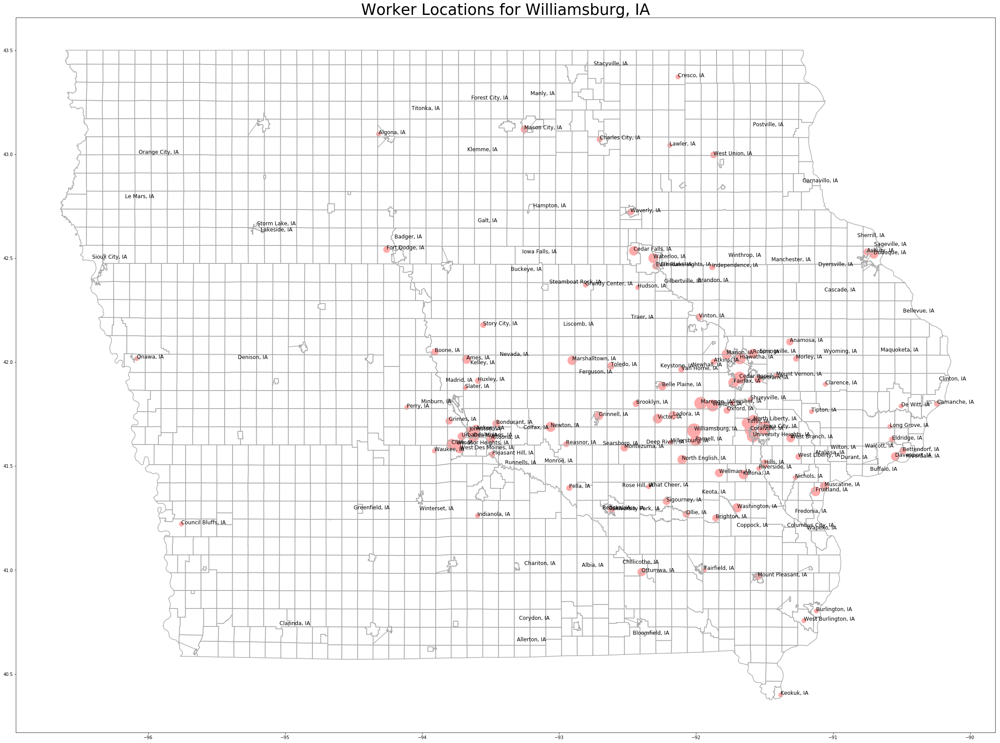

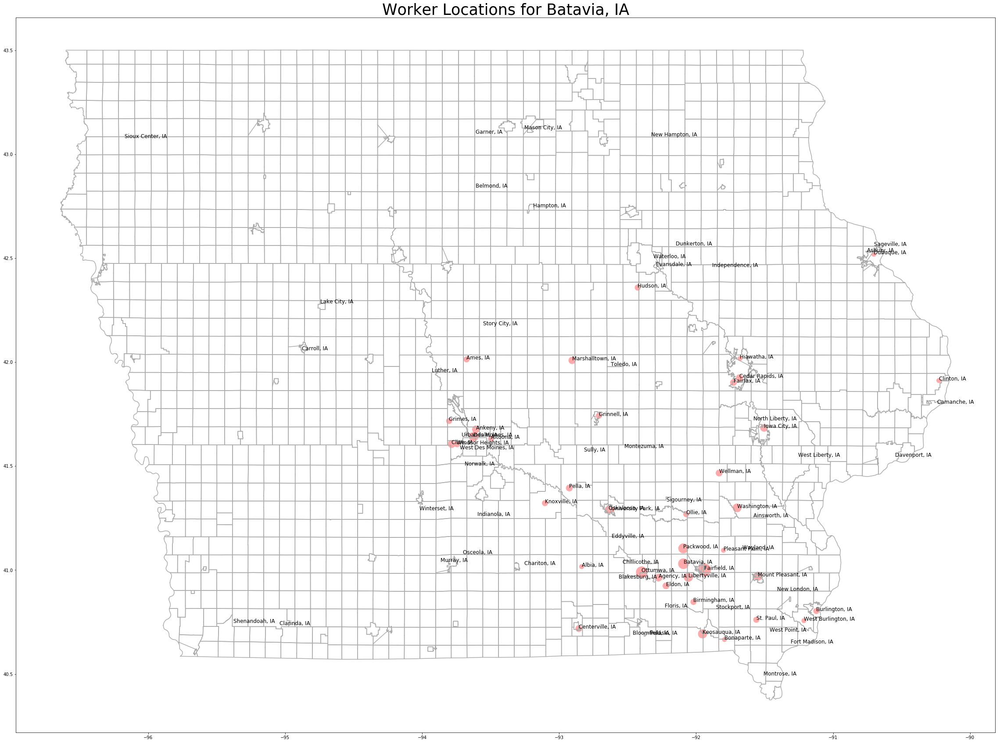

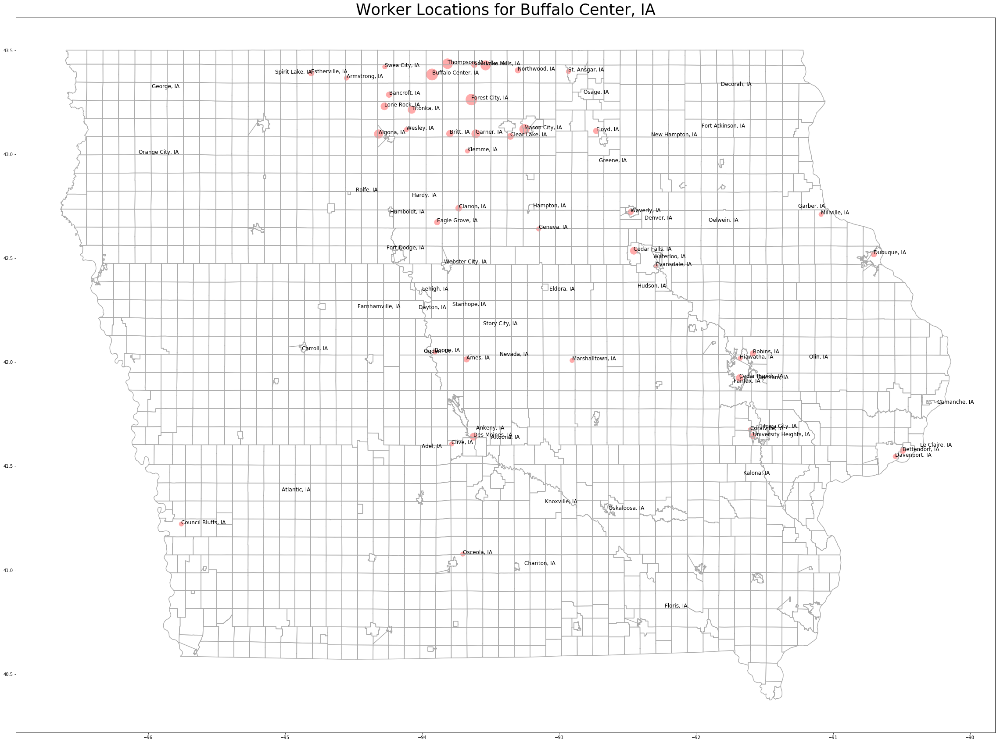

...

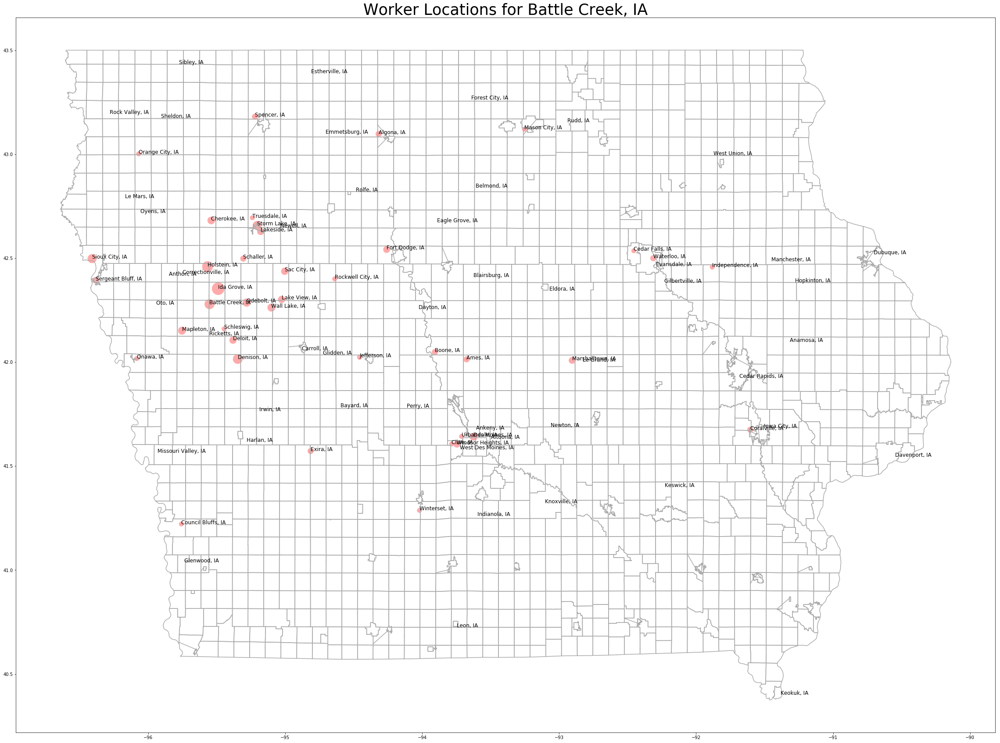

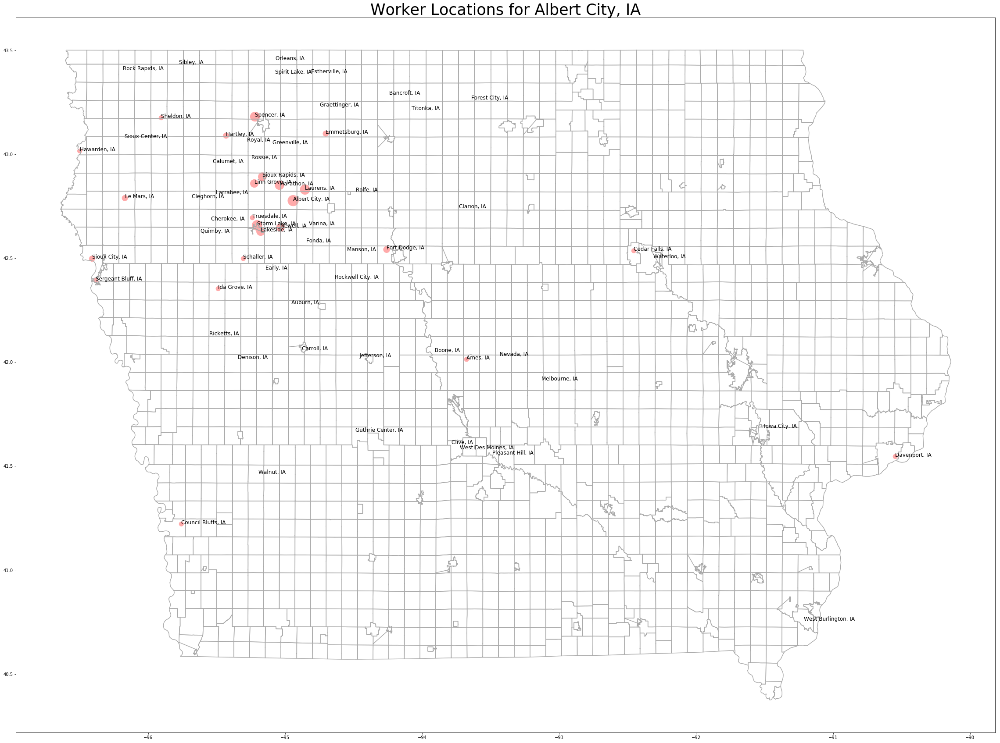

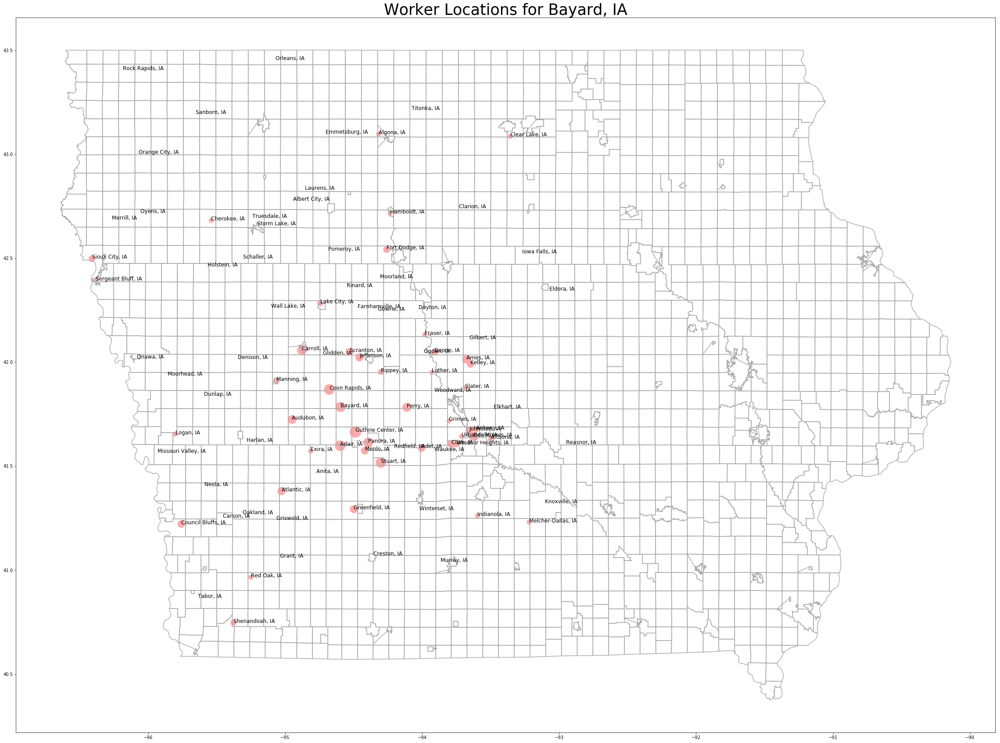

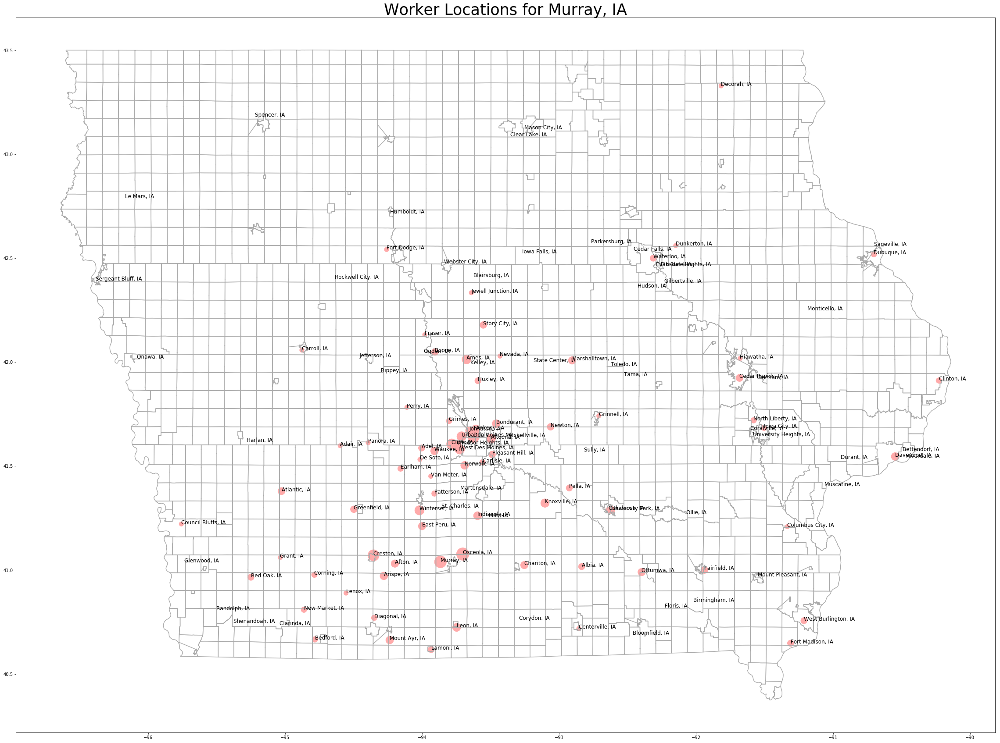

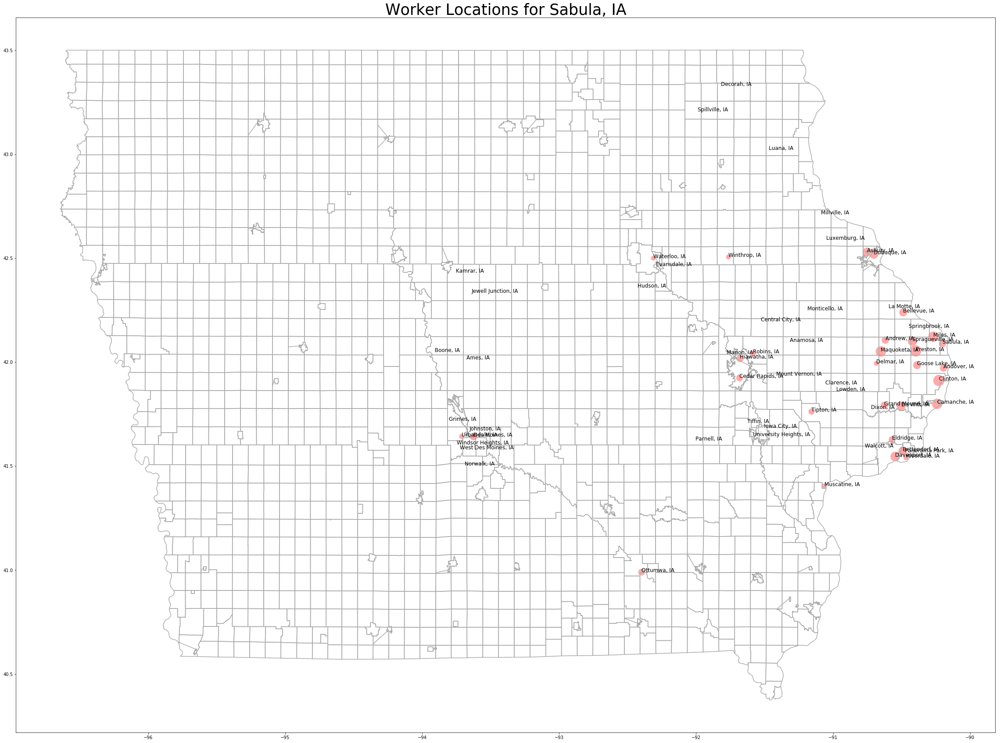

In [74]:
import math
import matplotlib.pyplot as plt
import sys
sys.path.insert(0, '/Users/ewd/ShrinkSmart/')
from ShrinkSmart import ShrinkSmart
%matplotlib inline

jobFlow = pd.pivot_table(testSet, index=["home city", "work city"], aggfunc=sum).reset_index()
iowa = shapefile.Reader("tl_2016_19_cousub.shp")

for city in ShrinkSmart.cities:
    jobPlot = jobFlow.loc[jobFlow["home city"] == city].sort_values("total jobs", ascending=0)
    jobPlot["x"] = jobPlot["work city"].apply(lambda x: lonDict[x])
    jobPlot["y"] = jobPlot["work city"].apply(lambda x: latDict[x])
    jobPlot["log jobs"] = jobPlot["total jobs"].apply(lambda x: math.log(x))

    jobFlow["lon work"] = jobFlow["work city"].apply(lambda x: lonDict[x])
    jobFlow["lat work"] = jobFlow["work city"].apply(lambda x: latDict[x])

    fig = plt.figure(figsize=(40,30))
    ax = fig.add_subplot(111)
    for shape in iowa.shapeRecords():
        xs = [i[0] for i in shape.shape.points[:]]
        ys = [i[1] for i in shape.shape.points[:]]
        plt.plot(xs,ys,c="#aaaaaa")

    plt.scatter(jobPlot["x"], jobPlot["y"], s=150*jobPlot["log jobs"], c="#ffaaaa")
    jobPlot.apply(lambda x: ax.annotate(x["work city"], xy=(x["x"],x["y"]), size=12), axis=1)
    plt.title('Worker Locations for ' + city, size="35")
    plt.savefig("figs/worker_plot_" + re.sub("[^\w]+", "_", city) + ".png")
    
#jobFlow.to_csv("iowa-job-flow.csv")
#jobFlow

In [75]:
featureData = pd.DataFrame(jobFlow)
featureData["lon home"] = featureData["home city"].apply(lambda x: float(lonDf[lonDf["index"] == x][0]))
featureData["lat home"] = featureData["home city"].apply(lambda x: float(latDf[latDf["index"] == x][0]))
featureData.to_csv("iowa-job-out.csv")

In [76]:
featureData

,home city,work city,Age [0-29],Age [30-54],Age [55+],Jobs: Goods Producing,Jobs: Other,"Jobs: Trade, Transport, Utilities","Salary, Monthly [0-1250]","Salary, Monthly [1251-3333]","Salary, Monthly [3334+]",total jobs,lon work,lat work,lon home,lat home
0,"Ackley, IA","Ackley, IA",35,81,49,14,129,22,69,63,33,165,-93.096785,42.481829,-93.096785,42.481829
1,"Ackley, IA","Adel, IA",0,2,0,0,2,0,0,1,1,2,-94.003488,41.587105,-93.096785,42.481829
2,"Ackley, IA","Albion, IA",0,1,0,0,0,1,0,1,0,1,-93.063872,42.127289,-93.096785,42.481829
3,"Ackley, IA","Alden, IA",1,2,2,3,2,0,0,1,4,5,-93.335519,42.526676,-93.096785,42.481829
4,"Ackley, IA","Alexander, IA",0,3,0,0,0,3,0,2,1,3,-93.441878,42.768255,-93.096785,42.481829
5,"Ackley, IA","Algona, IA",0,1,0,1,0,0,0,0,1,1,-94.317379,43.097394,-93.096785,42.481829
6,"Ackley, IA","Altoona, IA",0,1,0,0,1,0,1,0,0,1,-93.495729,41.631887,-93.096785,42.481829
7,"Ackley, IA","Ames, IA",7,5,1,0,11,2,7,5,1,13,-93.675477,42.013348,-93.096785,42.481829
8,"Ackley, IA","Anamosa, IA",0,0,1,0,1,0,0,0,1,1,-91.315158,42.097537,-93.096785,42.481829
9,"Ackley, IA","Ankeny, IA",9,5,3,6,4,7,4,9,4,17,-93.607111,41.676895,-93.096785,42.481829


In [77]:
from tqdm import tqdm

workSet = pd.DataFrame(featureData)
#workSet = workSet.drop(['work block', 'home block'], axis=1)
#testSet = testSet.groupby(['wb census', 'hb census']).sum().reset_index()
#workSet["home city"] = workSet["hb census"].apply(getCity)
#workSet = workSet.drop("hb census", axis=1)
#workSet["work city"] = workSet["wb census"].apply(getCity)
#workSet = workSet.drop("wb census", axis=1)
workSet.sort_values(["work city", "home city"], inplace=True)
workSet.set_index(["work city", "home city"], inplace=True)
workPivot = pd.pivot_table(workSet, index=["work city", "home city"], aggfunc=sum).reset_index()
#workPlot = workFlow.loc[workFlow["work city"] == "Altoona, IA"].sort_values("total jobs", ascending=0)
#workPivot = workPivot.drop(["x(h)"], axis=1)
workPivot

,work city,home city,Age [0-29],Age [30-54],Age [55+],Jobs: Goods Producing,Jobs: Other,"Jobs: Trade, Transport, Utilities","Salary, Monthly [0-1250]","Salary, Monthly [1251-3333]","Salary, Monthly [3334+]",lat home,lat work,lon home,lon work,total jobs
0,"Ackley, IA","Ackley, IA",35,81,49,14,129,22,69,63,33,42.481829,42.481829,-93.096785,-93.096785,165
1,"Ackley, IA","Ainsworth, IA",0,0,1,0,1,0,0,1,0,41.254666,42.481829,-91.580000,-93.096785,1
2,"Ackley, IA","Albion, IA",0,2,0,1,0,1,0,0,2,42.127289,42.481829,-93.063872,-93.096785,2
3,"Ackley, IA","Alden, IA",0,2,1,0,2,1,0,2,1,42.526676,42.481829,-93.335519,-93.096785,3
4,"Ackley, IA","Allison, IA",0,2,0,1,1,0,0,2,0,42.815019,42.481829,-92.820706,-93.096785,2
5,"Ackley, IA","Ames, IA",2,0,1,0,2,1,1,1,1,42.013348,42.481829,-93.675477,-93.096785,3
6,"Ackley, IA","Anamosa, IA",0,1,0,0,1,0,0,0,1,42.097537,42.481829,-91.315158,-93.096785,1
7,"Ackley, IA","Ankeny, IA",0,0,1,0,1,0,0,0,1,41.676895,42.481829,-93.607111,-93.096785,1
8,"Ackley, IA","Aredale, IA",0,4,1,1,4,0,0,3,2,42.818184,42.481829,-92.963085,-93.096785,5
9,"Ackley, IA","Arlington, IA",0,1,0,0,0,1,0,0,1,42.751656,42.481829,-91.761506,-93.096785,1


In [78]:
workPivot.to_csv("iowa-work-flow.csv")